# Clustering and dimensionality reduction techniques combined

In this notebook, we show how the clustering performance changes when dimensionality reduction techniques like Principal component analysis (PCA), Independent component analysis (ICA), or Random projections (RP) is combined with algorithms like k-means.

Read about [k-means clustering](https://en.wikipedia.org/wiki/K-means_clustering), [PCA](https://en.wikipedia.org/wiki/Principal_component_analysis), [ICA](https://en.wikipedia.org/wiki/Independent_component_analysis)

---

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

### Create synthetic data using Scikit learn `make_blob` method

- Number of features: 8
- Number of clusters: 5
- Number of samples: 1000

In [2]:
from sklearn.datasets import make_classification
from sklearn.datasets import make_blobs

In [3]:
n_features = 8
n_cluster = 5
cluster_std = 1.5
n_samples = 1000

In [4]:
data1 = make_blobs(n_samples=n_samples,n_features=n_features,centers=n_cluster,cluster_std=cluster_std)

In [5]:
d1 = data1[0]

In [6]:
df1=pd.DataFrame(data=d1,columns=['Feature_'+str(i) for i in range(1,n_features+1)])
df1.head()

,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,Feature_6,Feature_7,Feature_8
0,-7.510302,0.267474,1.545764,-7.364181,3.841632,9.527262,4.289097,-0.005708
1,9.840666,0.133922,8.293393,5.443509,3.634074,-6.490168,3.299960,-6.230022
2,-10.513347,2.478059,3.400120,-6.504996,1.174040,9.020070,4.969351,2.442962
3,-9.801366,2.488951,1.097999,-6.189231,2.867490,13.113106,5.925875,1.265171
4,-0.716918,5.714763,-2.054104,6.620783,-9.590642,-0.763585,0.663537,-10.882163


In [7]:
from itertools import combinations

In [8]:
lst_vars=list(combinations(df1.columns,2))

In [9]:
len(lst_vars)

28

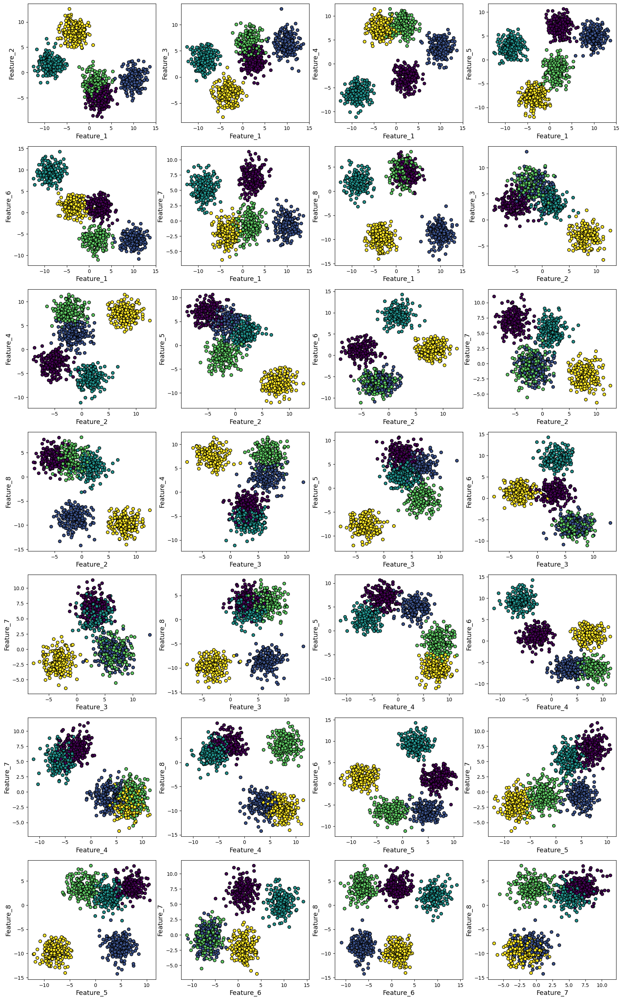

In [10]:
plt.figure(figsize=(21,35))
for i in range(1,29):
    plt.subplot(7,4,i)
    dim1=lst_vars[i-1][0]
    dim2=lst_vars[i-1][1]
    plt.scatter(df1[dim1],df1[dim2],c=data1[1],edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

In [11]:
df1.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Feature_1,1000.0,0.358799,6.386079,-12.489901,-4.549714,1.029171,3.654169,13.692944
Feature_2,1000.0,0.186406,4.684820,-8.849035,-3.270619,-0.830674,2.513068,12.578719
Feature_3,1000.0,3.275509,3.885932,-7.686080,1.593604,4.066939,6.108086,13.031422
Feature_4,1000.0,1.956335,5.784094,-11.142359,-3.675009,3.258943,7.216621,11.487100
Feature_5,1000.0,0.853851,5.515829,-12.033201,-3.305613,2.401316,5.305994,10.628161
Feature_6,1000.0,-0.209351,6.082406,-11.112298,-5.983014,0.303296,3.030029,14.252457
Feature_7,1000.0,1.832954,3.931504,-6.408405,-1.356383,0.513216,5.665549,11.312162
Feature_8,1000.0,-1.796796,6.255096,-14.234691,-8.610646,1.506920,3.362538,8.177347


### How are the classes separated (boxplots)

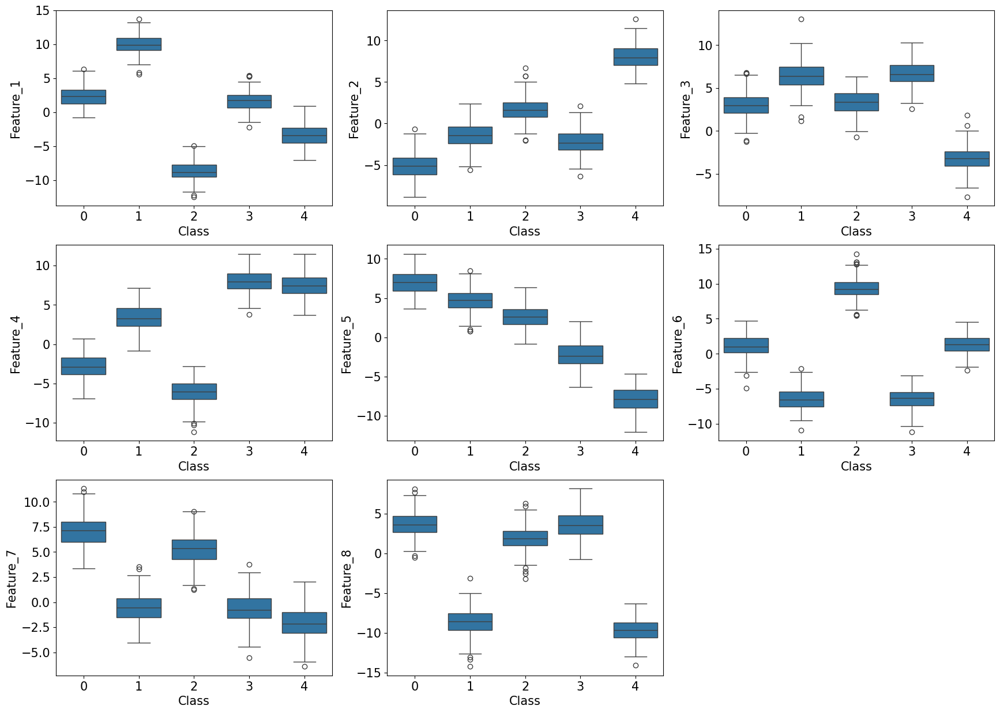

In [12]:
plt.figure(figsize=(21,15))
for i,c in enumerate(df1.columns):
    plt.subplot(3,3,i+1)
    sns.boxplot(y=df1[c],x=data1[1])
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.xlabel("Class",fontsize=15)
    plt.ylabel(c,fontsize=15)
    #plt.show()

## k-means clustering

In [13]:
from sklearn.cluster import KMeans

### Unlabled data

In [14]:
X=df1

In [15]:
X.head()

,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,Feature_6,Feature_7,Feature_8
0,-7.510302,0.267474,1.545764,-7.364181,3.841632,9.527262,4.289097,-0.005708
1,9.840666,0.133922,8.293393,5.443509,3.634074,-6.490168,3.299960,-6.230022
2,-10.513347,2.478059,3.400120,-6.504996,1.174040,9.020070,4.969351,2.442962
3,-9.801366,2.488951,1.097999,-6.189231,2.867490,13.113106,5.925875,1.265171
4,-0.716918,5.714763,-2.054104,6.620783,-9.590642,-0.763585,0.663537,-10.882163


In [16]:
y=data1[1]

### Scaling

In [17]:
from sklearn.preprocessing import MinMaxScaler

In [18]:
scaler = MinMaxScaler()

In [19]:
X_scaled=scaler.fit_transform(X)

### Metrics

In [20]:
from sklearn.metrics import silhouette_score, adjusted_rand_score, completeness_score, v_measure_score

### Running k-means and computing inter-cluster distance score for various *k* values

In [21]:
km_scores= []
km_silhouette = []
vmeasure_score =[]
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_scaled)
    preds = km.predict(X_scaled)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_scaled)))
    km_scores.append(-km.score(X_scaled))
    silhouette = silhouette_score(X_scaled,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

Score for number of cluster(s) 2: -260.0896161444922
Silhouette score for number of cluster(s) 2: 0.4255189469017418
V-measure score for number of cluster(s) 2: 0.589727521756156
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -136.33476685571674
Silhouette score for number of cluster(s) 3: 0.5501104455291874
V-measure score for number of cluster(s) 3: 0.7918756684685214
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -82.32920845722363
Silhouette score for number of cluster(s) 4: 0.6097389315355072
V-measure score for number of cluster(s) 4: 0.9057460992755191
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -36.848062845143524
Silhouette score for number of cluster(s) 5: 0.6659623945807988
V-measure score for number of cluster(s

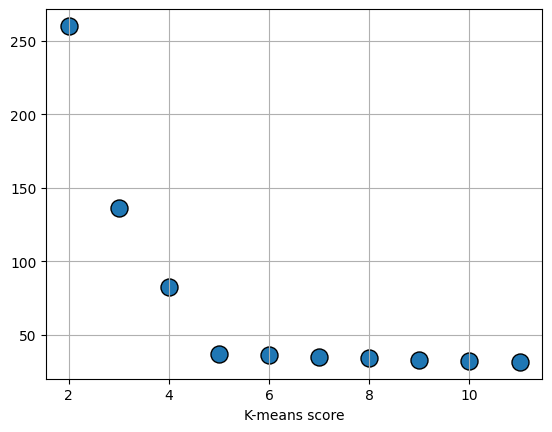

In [22]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("K-means score")
plt.show()

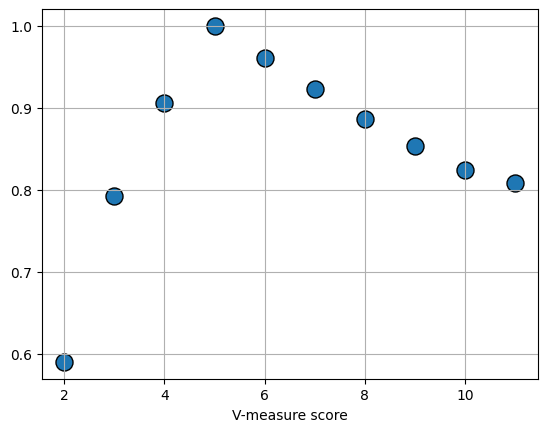

In [23]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("V-measure score")
plt.show()

In [24]:
km = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_scaled)

In [25]:
preds_km = km.predict(X_scaled)

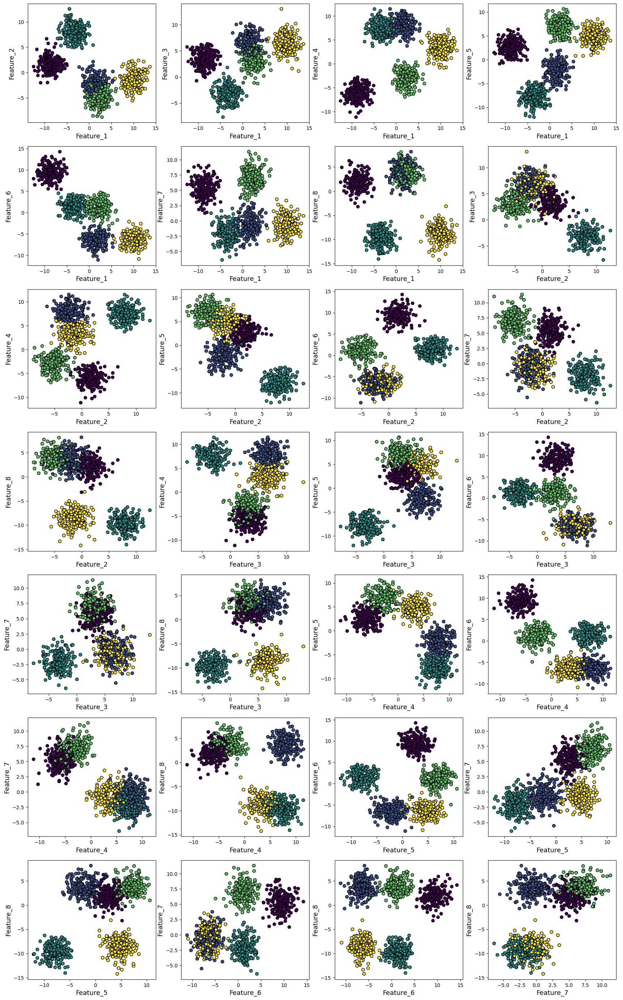

In [26]:
plt.figure(figsize=(21,35))
for i in range(1,29):
    plt.subplot(7,4,i)
    dim1=lst_vars[i-1][0]
    dim2=lst_vars[i-1][1]
    plt.scatter(df1[dim1],df1[dim2],c=preds_km,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## Expectation-maximization (Gaussian Mixture Model)

In [27]:
from sklearn.mixture import GaussianMixture

In [28]:
gm_bic= []
gm_score=[]
for i in range(2,12):
    gm = GaussianMixture(n_components=i,n_init=10,tol=1e-3,max_iter=1000).fit(X_scaled)
    print("BIC for number of cluster(s) {}: {}".format(i,gm.bic(X_scaled)))
    print("Log-likelihood score for number of cluster(s) {}: {}".format(i,gm.score(X_scaled)))
    print("-"*100)
    gm_bic.append(-gm.bic(X_scaled))
    gm_score.append(gm.score(X_scaled))

BIC for number of cluster(s) 2: -13088.708038418597
Log-likelihood score for number of cluster(s) 2: 6.851749129124004
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 3: -14848.689611996006
Log-likelihood score for number of cluster(s) 3: 7.887164409689806
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 4: -15442.491060354361
Log-likelihood score for number of cluster(s) 4: 8.339489627646083
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 5: -15963.450240707869
Log-likelihood score for number of cluster(s) 5: 8.755393711599934
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 6: -15731.433168623926
Log-likelihood score for number of cluster(s) 6: 8.79480966933506
--

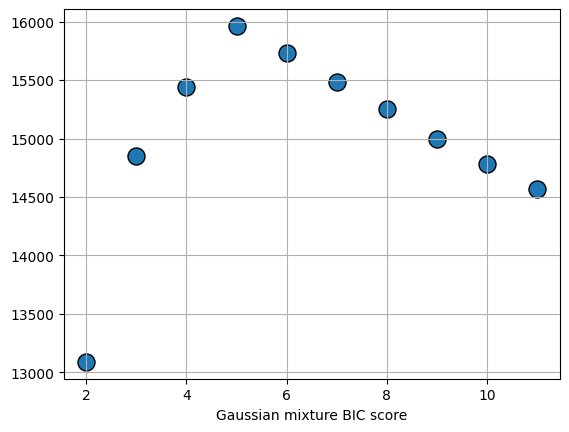

In [29]:
plt.scatter(x=[i for i in range(2,12)],y=gm_bic,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Gaussian mixture BIC score")
plt.show()

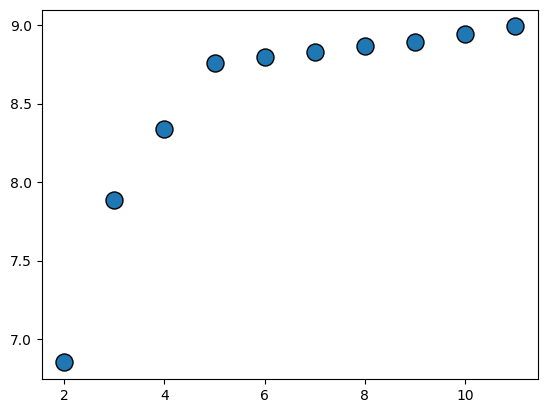

In [30]:
plt.scatter(x=[i for i in range(2,12)],y=gm_score,s=150,edgecolor='k')
plt.show()

In [31]:
gm = GaussianMixture(n_components=5,verbose=1,n_init=10,tol=1e-2,covariance_type='full',max_iter=1000).fit(X_scaled)

Initialization 0
Initialization converged.
Initialization 1
Initialization converged.
Initialization 2
Initialization converged.
Initialization 3
Initialization converged.
Initialization 4
Initialization converged.
Initialization 5
Initialization converged.
Initialization 6
Initialization converged.
Initialization 7
Initialization converged.
Initialization 8
Initialization converged.
Initialization 9
Initialization converged.


In [32]:
gm.means_

array([[0.1451456 , 0.49035205, 0.53422977, 0.22507315, 0.64738857,
        0.8069563 , 0.66189699, 0.72047226],
       [0.85658649, 0.34760769, 0.68256065, 0.63825178, 0.74089485,
        0.18288643, 0.32745694, 0.25047355],
       [0.34721622, 0.78542749, 0.21509457, 0.82165422, 0.18543509,
        0.49249012, 0.2478289 , 0.20291156],
       [0.53777637, 0.30973655, 0.69618911, 0.84494895, 0.43236077,
        0.18429362, 0.32759556, 0.79716975],
       [0.56692406, 0.17522614, 0.51741573, 0.36424047, 0.83731824,
        0.48260512, 0.76058702, 0.80379755]])

In [33]:
km.cluster_centers_

array([[0.1451456 , 0.49035205, 0.53422977, 0.22507315, 0.64738857,
        0.8069563 , 0.66189699, 0.72047226],
       [0.53777637, 0.30973655, 0.69618911, 0.84494895, 0.43236077,
        0.18429362, 0.32759556, 0.79716975],
       [0.34721622, 0.78542749, 0.21509457, 0.82165422, 0.18543509,
        0.49249012, 0.2478289 , 0.20291156],
       [0.56692406, 0.17522614, 0.51741573, 0.36424047, 0.83731824,
        0.48260512, 0.76058702, 0.80379755],
       [0.85658649, 0.34760769, 0.68256065, 0.63825178, 0.74089485,
        0.18288643, 0.32745694, 0.25047355]])

In [34]:
gm.means_/km.cluster_centers_

array([[1.        , 1.        , 1.        , 1.        , 1.        ,
        1.        , 1.        , 1.        ],
       [1.59283029, 1.12226887, 0.98042419, 0.75537318, 1.71360334,
        0.9923644 , 0.99957686, 0.31420354],
       [1.        , 1.        , 1.        , 1.        , 1.        ,
        1.        , 1.        , 1.        ],
       [0.94858625, 1.76763893, 1.34551207, 2.3197558 , 0.51636373,
        0.3818725 , 0.43071411, 0.99175439],
       [0.661841  , 0.50409167, 0.75805093, 0.57068462, 1.13014449,
        2.63882411, 2.32270848, 3.20911145]])

In [35]:
preds_gm=gm.predict(X_scaled)

In [36]:
km_rand_score = adjusted_rand_score(preds_km,y)

In [37]:
gm_rand_score = adjusted_rand_score(preds_gm,y)

In [38]:
print("Adjusted Rand score for k-means",km_rand_score)
print("Adjusted Rand score for Gaussian Mixture model",gm_rand_score)

Adjusted Rand score for k-means 1.0
Adjusted Rand score for Gaussian Mixture model 1.0


In [39]:
silhouette_score(X_scaled,preds_km)

0.6659623945807988

In [40]:
silhouette_score(X_scaled,preds_gm)

0.6659623945807988

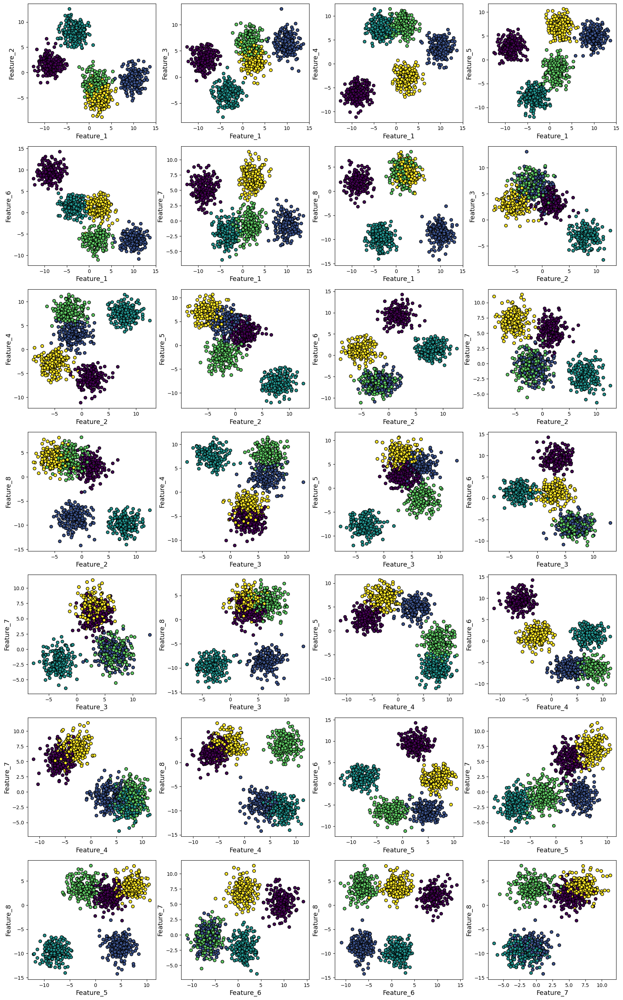

In [41]:
plt.figure(figsize=(21,35))
for i in range(1,29):
    plt.subplot(7,4,i)
    dim1=lst_vars[i-1][0]
    dim2=lst_vars[i-1][1]
    plt.scatter(df1[dim1],df1[dim2],c=preds_gm,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## PCA

In [42]:
from sklearn.decomposition import PCA

In [43]:
n_prin_comp = 3

In [44]:
pca_partial = PCA(n_components=n_prin_comp,svd_solver='full')
pca_partial.fit(X_scaled)

PCA(n_components=3, svd_solver='full')

In [45]:
pca_full = PCA(n_components=n_features,svd_solver='full')
pca_full.fit(X_scaled)

PCA(n_components=8, svd_solver='full')

### How much variance is explained by principal components?

With the help of this plot, we can decide to work with only the first 3 principal components

In [46]:
pca_explained_var = pca_full.explained_variance_ratio_

In [47]:
cum_explaiend_var = pca_explained_var.cumsum()

In [48]:
cum_explaiend_var

array([0.46288513, 0.79788885, 0.92283815, 0.95950178, 0.97275818,
       0.98332651, 0.99233631, 1.        ])

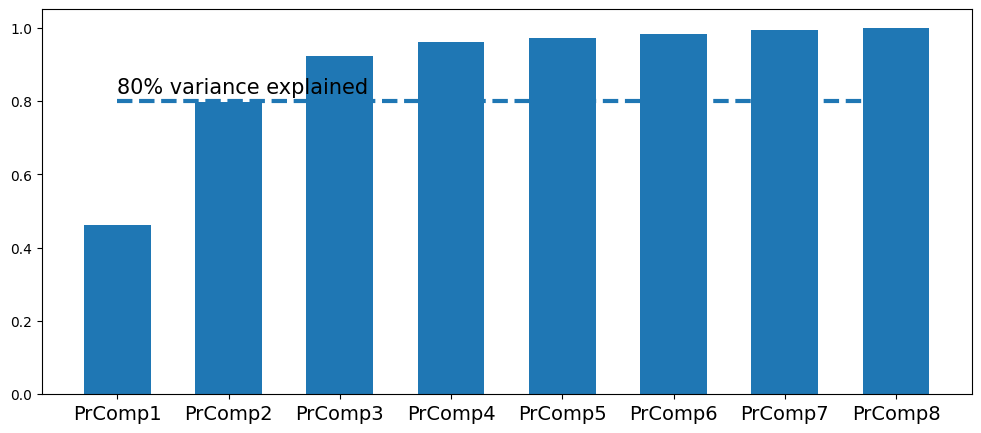

In [49]:
plt.figure(figsize=(12,5))
plt.bar(x=['PrComp'+str(i) for i in range(1,9)],height=cum_explaiend_var,width=0.6)
plt.xticks(fontsize=14)
plt.hlines(y=0.8,xmin='PrComp1',xmax='PrComp8',linestyles='dashed',lw=3)
plt.text(x='PrComp1',y=0.82,s="80% variance explained",fontsize=15)
plt.show()

### Transform the original variables in principal component space and create a DataFrame

In [50]:
X_pca = pca_partial.fit_transform(X_scaled)

In [51]:
df_pca=pd.DataFrame(data=X_pca,columns=['Principal_comp'+str(i) for i in range(1,n_prin_comp+1)])

### Running k-means on the transformed features

In [52]:
km_scores= []
km_silhouette = []
vmeasure_score =[]
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_pca)
    preds = km.predict(X_pca)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_pca)))
    km_scores.append(-km.score(X_pca))
    silhouette = silhouette_score(X_pca,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

Score for number of cluster(s) 2: -225.48908984957467
Silhouette score for number of cluster(s) 2: 0.47816442652650426
V-measure score for number of cluster(s) 2: 0.589727521756156
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -104.06832856237936
Silhouette score for number of cluster(s) 3: 0.6268754614859829
V-measure score for number of cluster(s) 3: 0.7918756684685214
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -67.13537685331607
Silhouette score for number of cluster(s) 4: 0.6635626731765256
V-measure score for number of cluster(s) 4: 0.9057460992755191
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -13.308288227101
Silhouette score for number of cluster(s) 5: 0.7905505613139676
V-measure score for number of cluster(s)

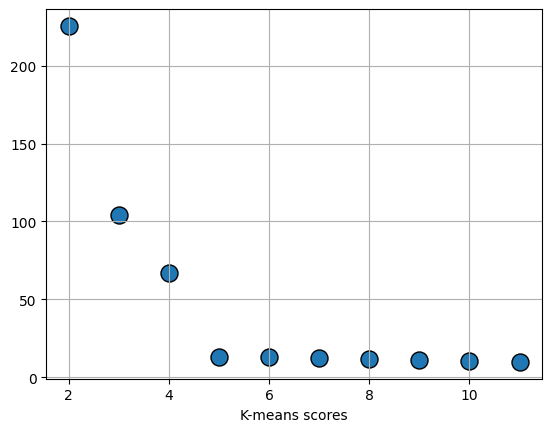

In [53]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("K-means scores")
plt.show()

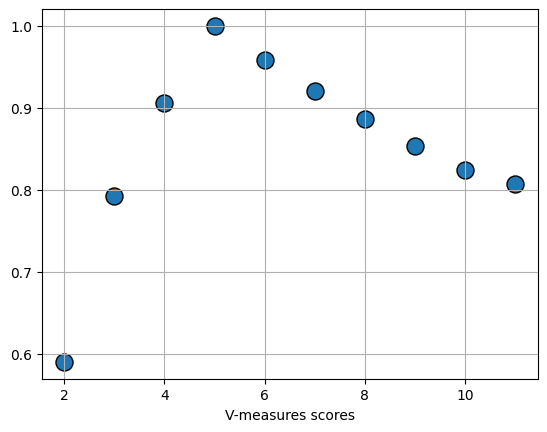

In [54]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("V-measures scores")
plt.show()

### K-means fitting with PCA-transformed data

In [55]:
km_pca = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_pca)
preds_km_pca = km_pca.predict(X_pca)

### Visualizing the clusters after running k-means on PCA-transformed features

In [56]:
col_pca_combi=list(combinations(df_pca.columns,2))
num_pca_combi = len(col_pca_combi)

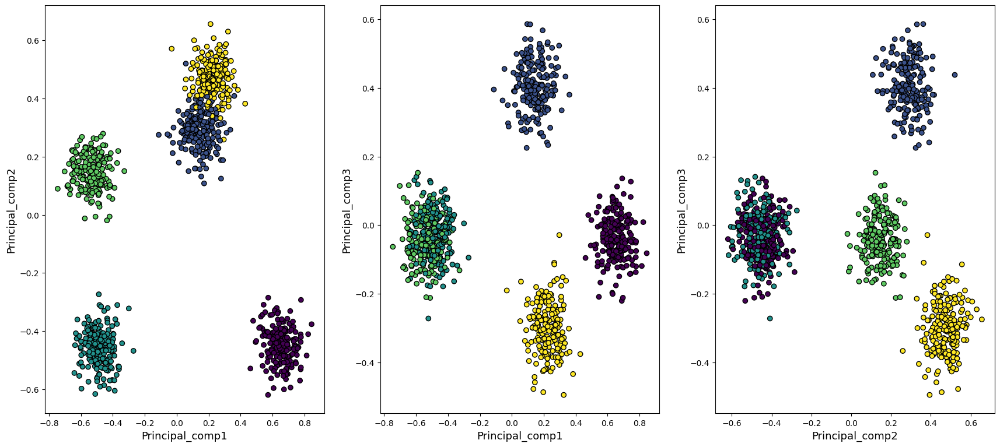

In [57]:
plt.figure(figsize=(21,20))
for i in range(1,num_pca_combi+1):
    plt.subplot(int(num_pca_combi/3)+1,3,i)
    dim1=col_pca_combi[i-1][0]
    dim2=col_pca_combi[i-1][1]
    plt.scatter(df_pca[dim1],df_pca[dim2],c=preds_km_pca,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## ICA

In [58]:
from sklearn.decomposition import FastICA

In [59]:
n_ind_comp = 3

In [60]:
ica_partial = FastICA(n_components=n_ind_comp)
ica_partial.fit(X_scaled)

FastICA(n_components=3)

In [61]:
ica_full = FastICA(max_iter=1000)
ica_full.fit(X_scaled)

/store/venv/da5401/lib/python3.10/site-packages/sklearn/decomposition/_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


FastICA(max_iter=1000)

In [62]:
X_ica = ica_partial.fit_transform(X_scaled)

In [63]:
df_ica=pd.DataFrame(data=X_ica,columns=['Independent_comp'+str(i) for i in range(1,n_ind_comp+1)])

### Running k-means on the independent features

In [64]:
km_scores= []
km_silhouette = []
vmeasure_score =[]
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_ica)
    preds = km.predict(X_ica)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_ica)))
    km_scores.append(-km.score(X_ica))
    silhouette = silhouette_score(X_ica,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

Score for number of cluster(s) 2: -2176.2069849419504
Silhouette score for number of cluster(s) 2: 0.35957338485243745
V-measure score for number of cluster(s) 2: 0.4657409167228561
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -1312.5181532331071
Silhouette score for number of cluster(s) 3: 0.5179407306469268
V-measure score for number of cluster(s) 3: 0.7424834172925042
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -374.8877356926054
Silhouette score for number of cluster(s) 4: 0.7145641482427763
V-measure score for number of cluster(s) 4: 0.9057460992755191
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -130.7266816077208
Silhouette score for number of cluster(s) 5: 0.7689322152415883
V-measure score for number of cluster

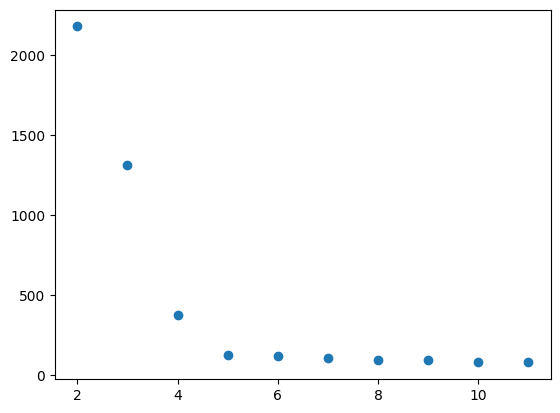

In [65]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores)
plt.show()

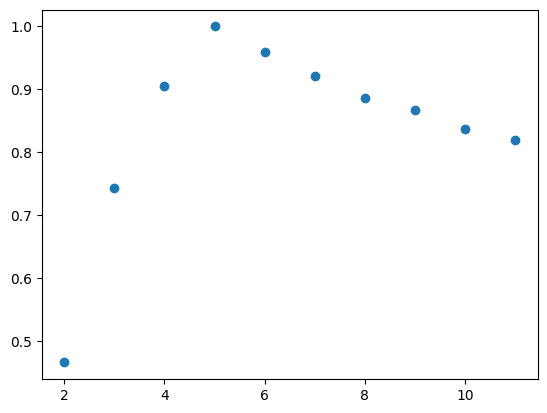

In [66]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score)
plt.show()

### K-means fitting with ICA-transformed data

In [67]:
km_ica = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_ica)
preds_km_ica = km_ica.predict(X_ica)

### Visualizing the clusters after running k-means on ICA-transformed features

In [68]:
col_ica_combi=list(combinations(df_ica.columns,2))
num_ica_combi = len(col_ica_combi)

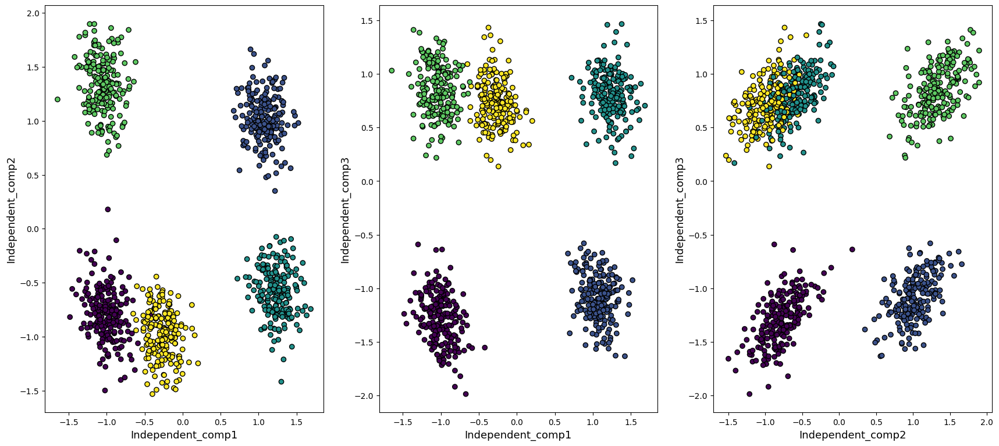

In [69]:
plt.figure(figsize=(21,20))
for i in range(1,num_ica_combi+1):
    plt.subplot(int(num_ica_combi/3)+1,3,i)
    dim1=col_ica_combi[i-1][0]
    dim2=col_ica_combi[i-1][1]
    plt.scatter(df_ica[dim1],df_ica[dim2],c=preds_km_ica,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## Random Projection

In [70]:
from sklearn.random_projection import GaussianRandomProjection

In [71]:
n_random_comp = 3

In [72]:
random_proj = GaussianRandomProjection(n_components=n_random_comp)

In [73]:
X_random_proj = random_proj.fit_transform(X_scaled)

In [74]:
df_random_proj=pd.DataFrame(data=X_random_proj,columns=['Random_projection'+str(i) for i in range(1,n_random_comp+1)])

### Running k-means on random projections

In [75]:
km_scores= []
km_silhouette = []
vmeasure_score = []
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_random_proj)
    preds = km.predict(X_random_proj)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_random_proj)))
    km_scores.append(-km.score(X_random_proj))
    silhouette = silhouette_score(X_random_proj,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

Score for number of cluster(s) 2: -190.68253519623943
Silhouette score for number of cluster(s) 2: 0.4929560468259265
V-measure score for number of cluster(s) 2: 0.589727521756156
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -108.4123352095379
Silhouette score for number of cluster(s) 3: 0.5616558434700096
V-measure score for number of cluster(s) 3: 0.7348116284788451
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -64.19334030088632
Silhouette score for number of cluster(s) 4: 0.5411673279764241
V-measure score for number of cluster(s) 4: 0.8206045612338547
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -33.147581796359304
Silhouette score for number of cluster(s) 5: 0.632905354111424
V-measure score for number of cluster(s)

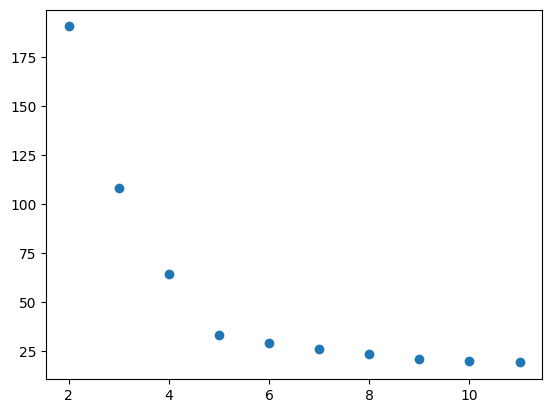

In [76]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores)
plt.show()

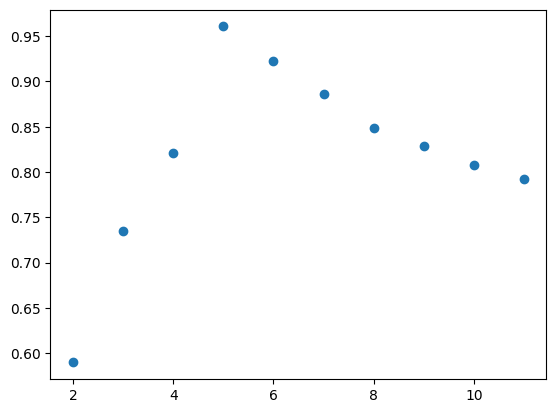

In [77]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score)
plt.show()

### K-means fitting with random-projected data

In [78]:
km_random_proj = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_random_proj)
preds_km_random_proj = km_random_proj.predict(X_random_proj)

### Visualizing the clusters after running k-means on random-projected features

In [79]:
col_random_proj_combi=list(combinations(df_random_proj.columns,2))
num_random_proj_combi = len(col_random_proj_combi)

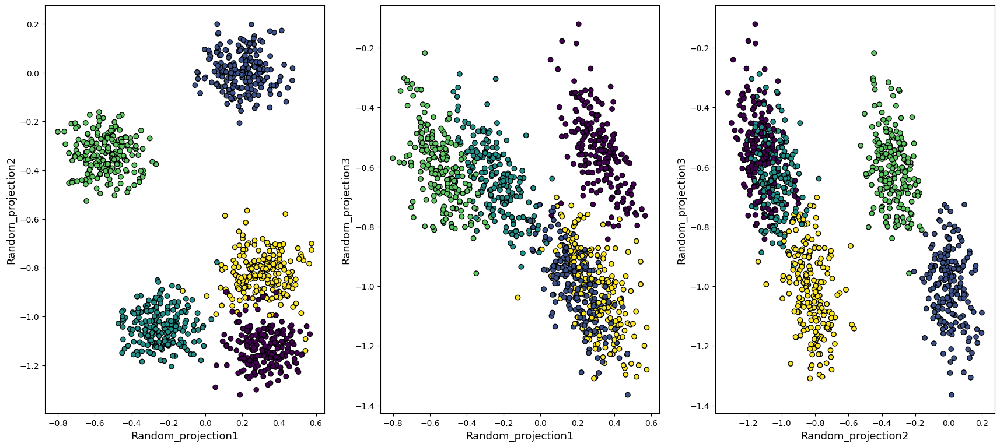

In [80]:
plt.figure(figsize=(21,20))
for i in range(1,num_random_proj_combi+1):
    plt.subplot(int(num_random_proj_combi/3)+1,3,i)
    dim1=col_random_proj_combi[i-1][0]
    dim2=col_random_proj_combi[i-1][1]
    plt.scatter(df_random_proj[dim1],df_random_proj[dim2],c=preds_km_random_proj,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)
plt.show()

In [81]:
def plot_cluster_rp(df_rp,preds_rp):
    """
    Plots clusters after running random projection
    """
    plt.figure(figsize=(21,12))
    for i in range(1,num_random_proj_combi+1):
        plt.subplot(int(num_random_proj_combi/3)+1,3,i)
        dim1=col_random_proj_combi[i-1][0]
        dim2=col_random_proj_combi[i-1][1]
        plt.scatter(df_rp[dim1],df_rp[dim2],c=preds_rp,edgecolor='k')
        plt.xlabel(f"{dim1}",fontsize=13)
        plt.ylabel(f"{dim2}",fontsize=13)
    plt.show()

### Running the random projections many times

Score for iteration 0: -51.41552854398479
Silhouette score for iteration 0: 0.5015784448379318
V-measure score for iteration 0: 0.8574279941381983
----------------------------------------------------------------------------------------------------


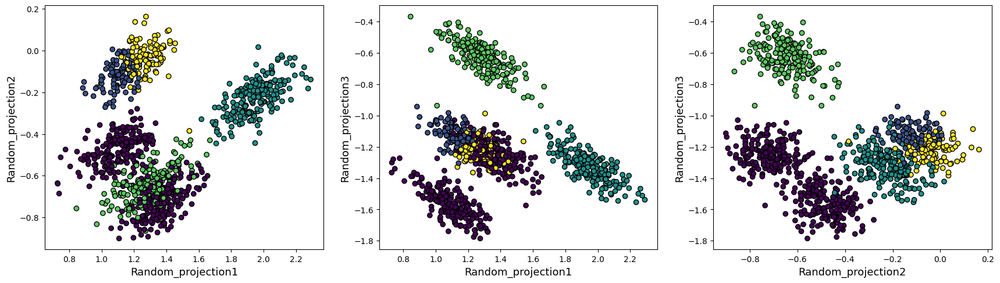

Score for iteration 1: -72.38149036840794
Silhouette score for iteration 1: 0.5800301133285349
V-measure score for iteration 1: 0.8651198637073775
----------------------------------------------------------------------------------------------------


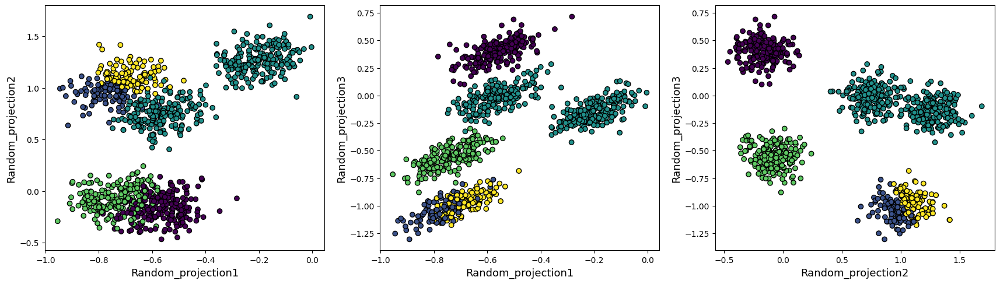

Score for iteration 2: -29.98246079700973
Silhouette score for iteration 2: 0.3653668047034514
V-measure score for iteration 2: 0.7125912343344828
----------------------------------------------------------------------------------------------------


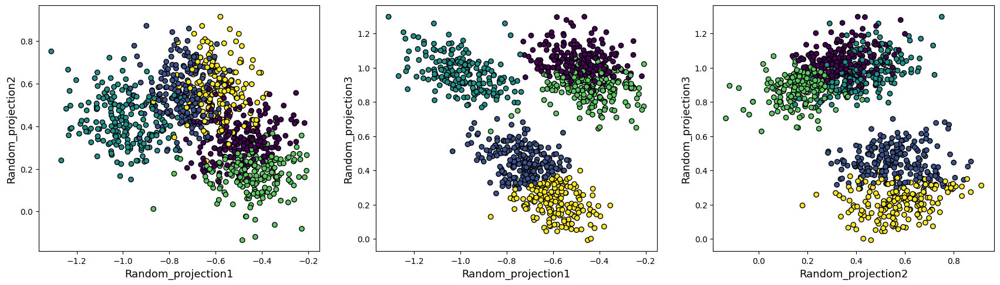

Score for iteration 3: -54.063661259936396
Silhouette score for iteration 3: 0.43144513567579884
V-measure score for iteration 3: 0.727924533259921
----------------------------------------------------------------------------------------------------


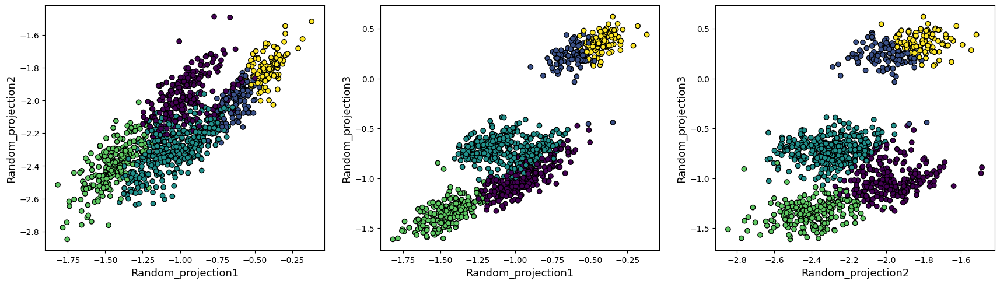

Score for iteration 4: -50.63963878188274
Silhouette score for iteration 4: 0.545353927559822
V-measure score for iteration 4: 0.8432923271180417
----------------------------------------------------------------------------------------------------


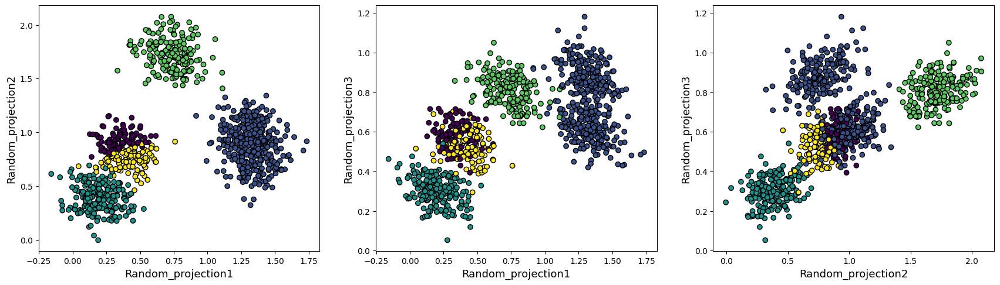

Score for iteration 5: -44.32440536439219
Silhouette score for iteration 5: 0.38532960166114205
V-measure score for iteration 5: 0.6621245114399085
----------------------------------------------------------------------------------------------------


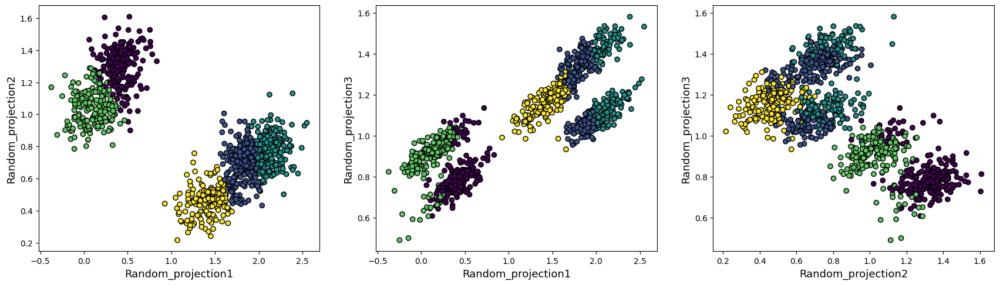

Score for iteration 6: -41.39839466181504
Silhouette score for iteration 6: 0.5230871961115791
V-measure score for iteration 6: 0.8450395654317201
----------------------------------------------------------------------------------------------------


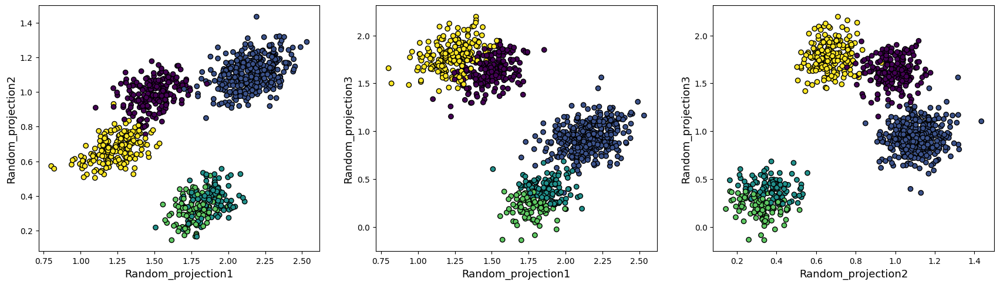

Score for iteration 7: -33.03451181228619
Silhouette score for iteration 7: 0.3800517123887614
V-measure score for iteration 7: 0.7199768233218956
----------------------------------------------------------------------------------------------------


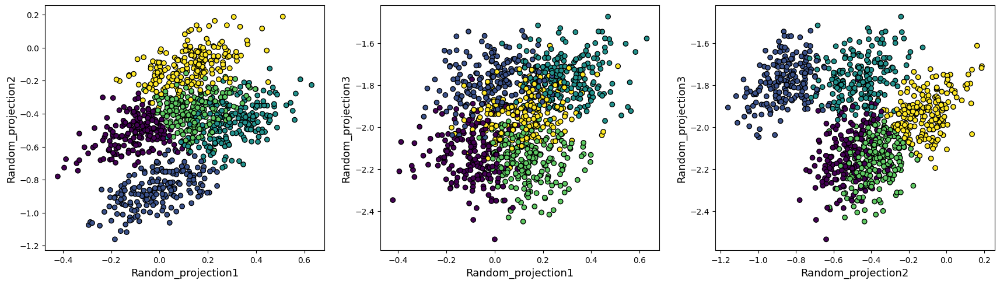

Score for iteration 8: -34.17147780747686
Silhouette score for iteration 8: 0.6709291613161051
V-measure score for iteration 8: 1.0
----------------------------------------------------------------------------------------------------


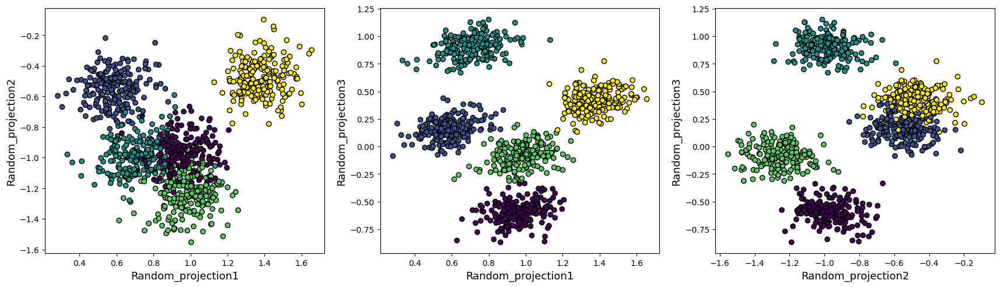

Score for iteration 9: -56.74152787174473
Silhouette score for iteration 9: 0.6220224036202664
V-measure score for iteration 9: 0.9785831170740644
----------------------------------------------------------------------------------------------------


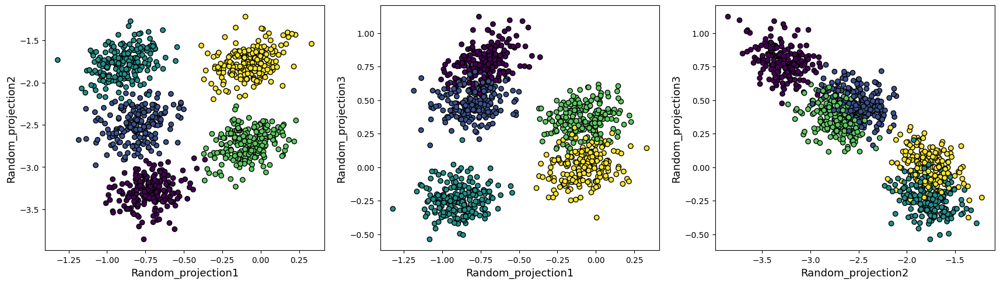

Score for iteration 10: -43.29317687393768
Silhouette score for iteration 10: 0.5759837428535672
V-measure score for iteration 10: 0.9543343576944058
----------------------------------------------------------------------------------------------------


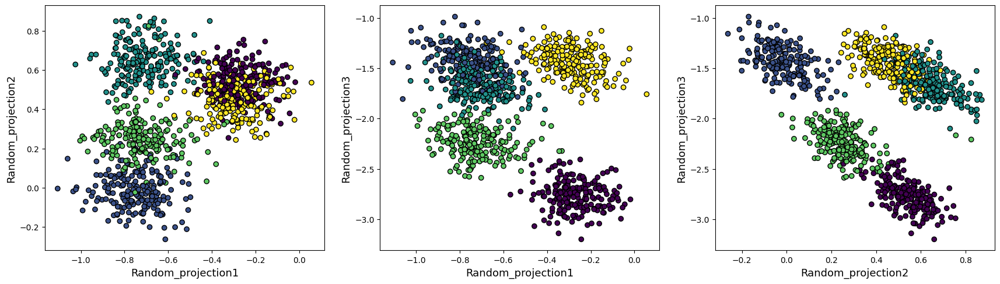

Score for iteration 11: -24.87527460907301
Silhouette score for iteration 11: 0.48122640145250767
V-measure score for iteration 11: 0.7571153261729501
----------------------------------------------------------------------------------------------------


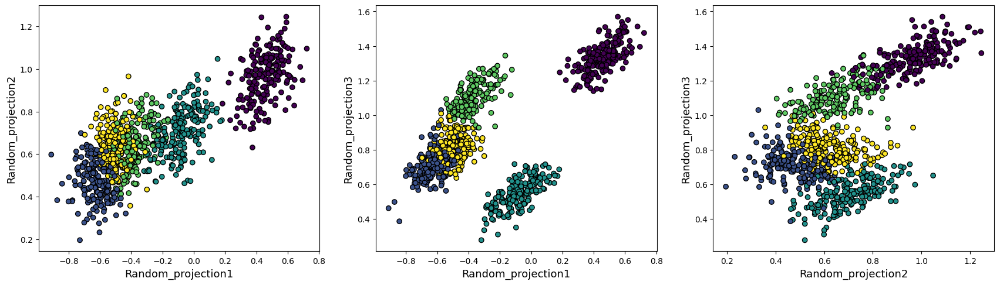

Score for iteration 12: -38.02512973476473
Silhouette score for iteration 12: 0.5815117794936178
V-measure score for iteration 12: 0.9008806279269629
----------------------------------------------------------------------------------------------------


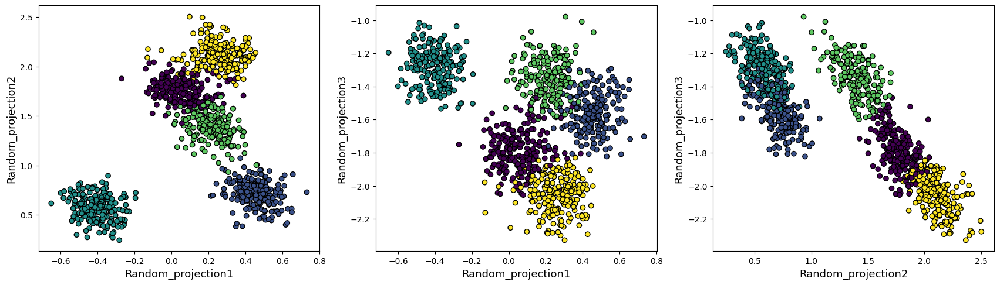

Score for iteration 13: -42.34554286173209
Silhouette score for iteration 13: 0.5338411393849455
V-measure score for iteration 13: 0.8972433692710828
----------------------------------------------------------------------------------------------------


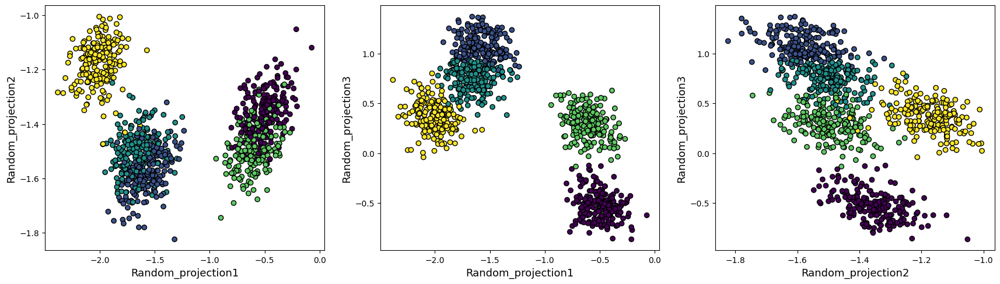

Score for iteration 14: -33.89984447820899
Silhouette score for iteration 14: 0.6361653412820142
V-measure score for iteration 14: 0.9688394317136985
----------------------------------------------------------------------------------------------------


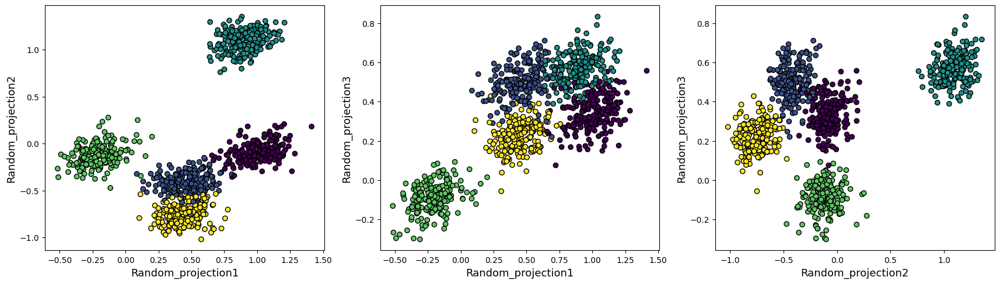

Score for iteration 15: -42.747910693178994
Silhouette score for iteration 15: 0.49711888637641705
V-measure score for iteration 15: 0.8331762465674664
----------------------------------------------------------------------------------------------------


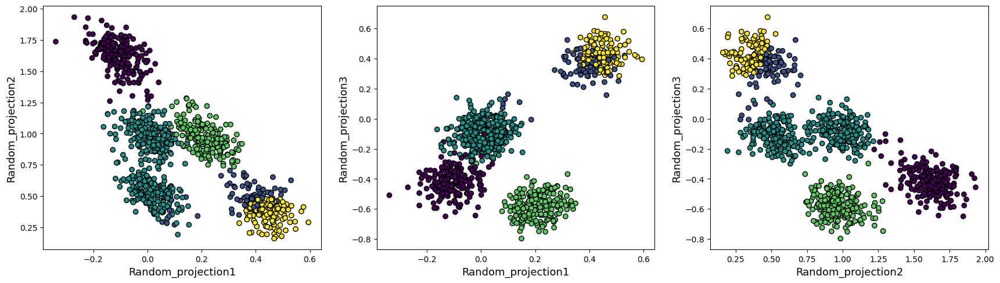

Score for iteration 16: -40.848688535872945
Silhouette score for iteration 16: 0.5569962820781131
V-measure score for iteration 16: 0.9524739340310754
----------------------------------------------------------------------------------------------------


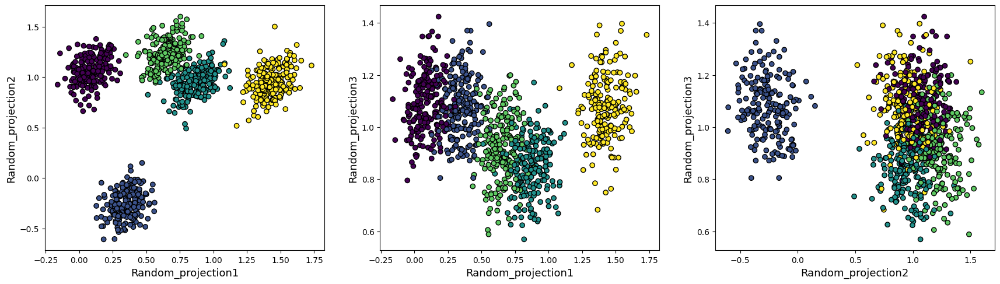

Score for iteration 17: -30.040950234441524
Silhouette score for iteration 17: 0.5472194899885605
V-measure score for iteration 17: 0.9198095999912761
----------------------------------------------------------------------------------------------------


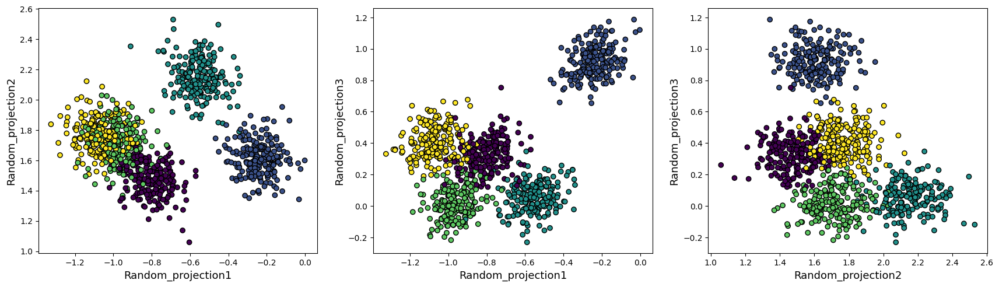

Score for iteration 18: -41.96410456387685
Silhouette score for iteration 18: 0.5656646255065745
V-measure score for iteration 18: 0.953568971346011
----------------------------------------------------------------------------------------------------


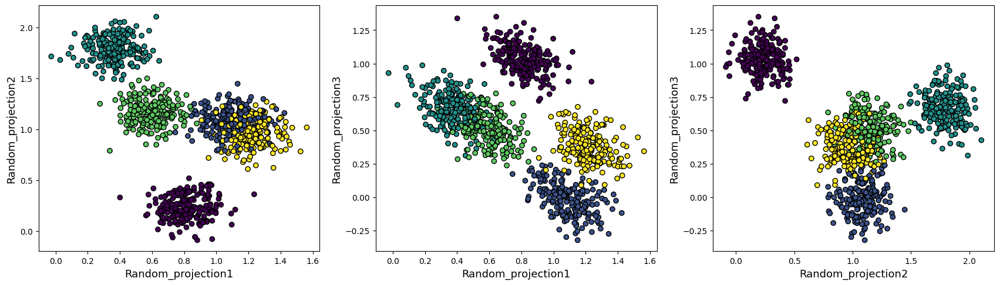

Score for iteration 19: -34.41873982325295
Silhouette score for iteration 19: 0.5539478723223972
V-measure score for iteration 19: 0.9324937360286302
----------------------------------------------------------------------------------------------------


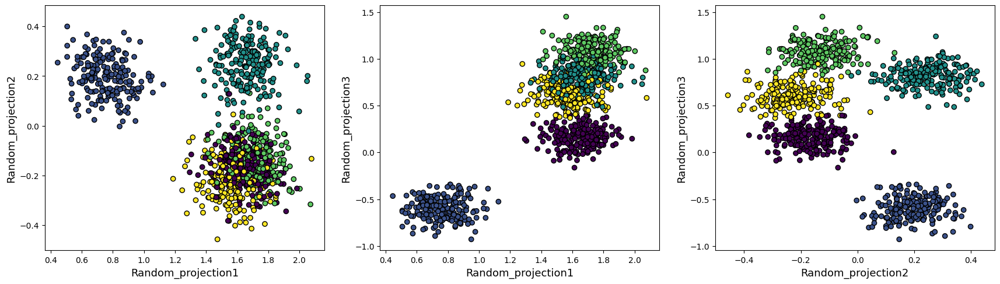

In [82]:
rp_score= []
rp_silhouette = []
rp_vmeasure = []
for i in range(20):
    random_proj = GaussianRandomProjection(n_components=n_random_comp)
    X_random_proj = random_proj.fit_transform(X_scaled)
    df_random_proj=pd.DataFrame(data=X_random_proj,columns=['Random_projection'+str(i) for i in range(1,n_random_comp+1)])
    
    km = KMeans(n_clusters=5, random_state=0).fit(X_random_proj)
    preds = km.predict(X_random_proj)
    print("Score for iteration {}: {}".format(i,km.score(X_random_proj)))
    rp_score.append(-km.score(X_random_proj))
    
    silhouette = silhouette_score(X_random_proj,preds)
    rp_silhouette.append(silhouette)
    print("Silhouette score for iteration {}: {}".format(i,silhouette))
    
    v_measure = v_measure_score(y,preds)
    rp_vmeasure.append(v_measure)
    print("V-measure score for iteration {}: {}".format(i,v_measure))
    print("-"*100)
    
    plot_cluster_rp(df_random_proj,preds)

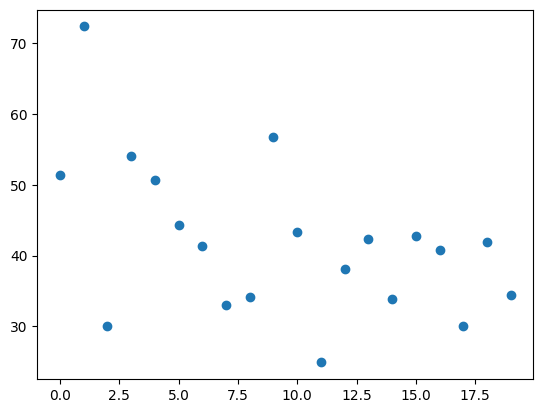

In [83]:
plt.scatter(x=[i for i in range(20)],y=rp_score)
plt.show()

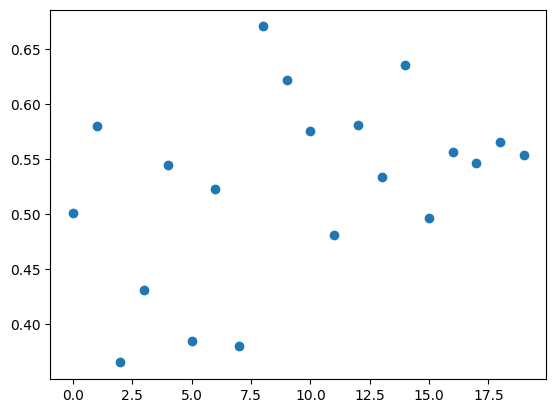

In [84]:
plt.scatter(x=[i for i in range(20)],y=rp_silhouette)
plt.show()

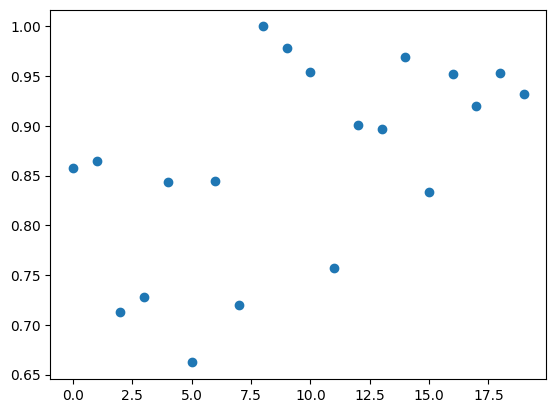

In [85]:
plt.scatter(x=[i for i in range(20)],y=rp_vmeasure)
plt.show()

### This kind of variation does not happen with PCA

In [86]:
pca_score= []
pca_silhouette = []
pca_vmeasure = []
for i in range(20):
    pca_partial = PCA(n_components=n_prin_comp,svd_solver='full')
    X_pca=pca_partial.fit_transform(X_scaled)
    km = KMeans(n_clusters=5, random_state=0).fit(X_pca)
    preds = km.predict(X_pca)
    print("Score for iteration {}: {}".format(i,km.score(X_pca)))
    rp_score.append(-km.score(X_pca))
    silhouette = silhouette_score(X_pca,preds)
    rp_silhouette.append(silhouette)
    print("Silhouette score for iteration {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    rp_vmeasure.append(v_measure)
    print("V-measure score for iteration {}: {}".format(i,v_measure))
    print("-"*100)

Score for iteration 0: -13.308288227101
Silhouette score for iteration 0: 0.7905505613139676
V-measure score for iteration 0: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 1: -13.308288227101
Silhouette score for iteration 1: 0.7905505613139676
V-measure score for iteration 1: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 2: -13.308288227101
Silhouette score for iteration 2: 0.7905505613139676
V-measure score for iteration 2: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 3: -13.308288227101002
Silhouette score for iteration 3: 0.7905505613139676
V-measure score for iteration 3: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 4: -13.308288227101
Silhouette score for iteration 4: